In [1]:
class SimulationParams:
    """A clean container holding all simulation parameters."""
    

    def __init__(self, params: dict):
        # 把所有参数写入成员变量
        for k, v in params.items():
            setattr(self, k, v)

    def __repr__(self):
        return "\n".join([f"{k} = {v}" for k, v in self.__dict__.items()])


def load_simulation_params(path):
    params = {}

    with open(path, "r") as f:
        for line in f:
            if "=" not in line:
                continue

            k, v = line.split("=")
            k = k.strip()
            v = v.strip()

            # attempt number conversion
            try:
                v = float(v) if "." in v else int(v)
            except:
                pass

            params[k] = v

    return SimulationParams(params)


In [2]:
from config_paths import OUT, FIGS
import numpy as np

param = load_simulation_params(f"{OUT}/params.txt")
print(param)          # 打印所有参数


e_SI = 1.602176634e-19 # C
m_e_SI = 9.10938356e-31 # kg
eps0_SI = 8.8541878128e-12 # F/m

# 以 1 eV 作为标准参考（可以自由改成你的基准）
Te_ref  = 1.0

# use ref parameter to calculate normalization scales
# plasma frequency of real n0_total in SI units
vth_ref_SI = np.sqrt(Te_ref * e_SI / m_e_SI)
omegap_beamn0_SI = param.omega_p_SI
lambdaD_SI = param.lambdaD_SI
print("omegap_beamn0_SI (rad/s):", omegap_beamn0_SI)
print("lambdaD_SI (m):", lambdaD_SI)

✅ [config_paths] 输出目录: c:\QIEN\Store\GitHub\Two-streamer-instability\output
✅ [config_paths] 图像目录: c:\QIEN\Store\GitHub\Two-streamer-instability\output\figs
Lx = 30.0
Nx = 64
Np = 500000
dt = 0.02
steps = 1000
v0 = 1.0
vth = 0.1
n0 = 1000000000000000.0
outdir = output
diag_interval = 10
phase_snap = 20
vth_ref_SI = 419382.8844972904
omega_p_SI = 1783986379.8348
lambdaD_SI = 0.00023508188696828836
dx = 0.46875
omegap_beamn0_SI (rad/s): 1783986379.8348
lambdaD_SI (m): 0.00023508188696828836


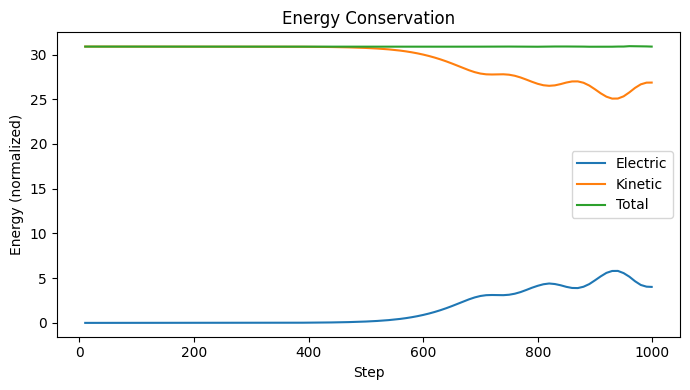

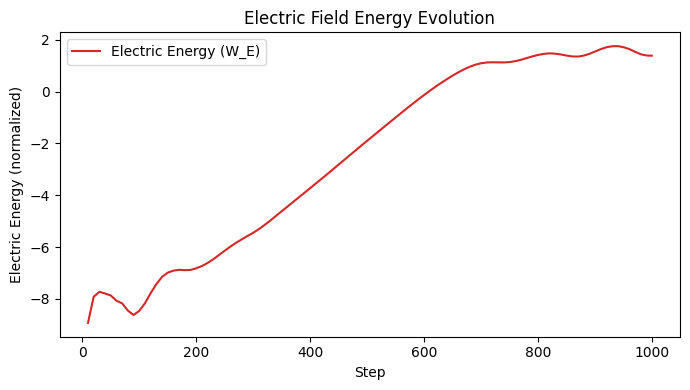

In [16]:
# diagnostics/plot_energy.py
import os, numpy as np, matplotlib.pyplot as plt
from diag_utils import ensure_dir, load_energy, robust_linear_fit
from config_paths import OUT, FIGS   # ✅ 直接导入全局路径

data = load_energy(OUT)
t, WE, WK, WT = data.T
# t = t*param.dt# /param.omega_p_SI  # 转为物理时间
# t

# -------------------------------
# 原有三条曲线：总能量图
# -------------------------------
plt.figure(figsize=(7,4))
plt.plot(t, WE, label="Electric")
plt.plot(t, WK, label="Kinetic")
plt.plot(t, WT, label="Total")
plt.xlabel("Step"); plt.ylabel("Energy (normalized)")
plt.title("Energy Conservation")
plt.legend(); plt.tight_layout()
# plt.savefig(os.path.join(FIGS, "energy_evolution.png"), dpi=150)


# -------------------------------
# 拟合增长率（线性阶段）
# -------------------------------
plt.figure(figsize=(7,4))
plt.plot(t, np.log(WE), color='tab:red', label="Electric Energy (W_E)")
plt.xlabel("Step"); plt.ylabel("Electric Energy (normalized)")
plt.title("Electric Field Energy Evolution")
plt.legend(); plt.tight_layout()



Fitted line: log(W_E) = -1.089e+01 + 1.797e-02 * t
γ (from energy fit) = 4.492e-01  (omegap_beam)
γ (from energy fit) = 8.013e+08  (1/s)


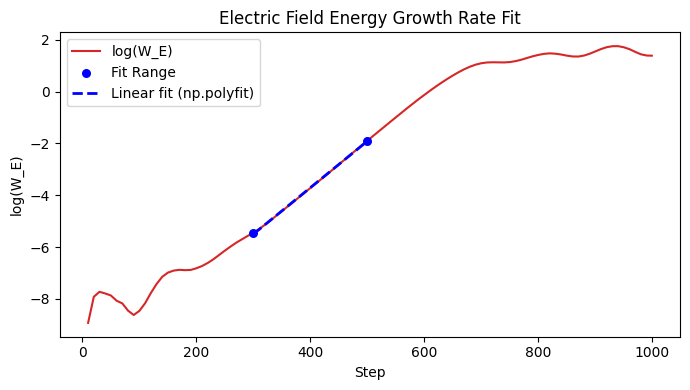

In [17]:
import math
data = load_energy(OUT)
t, WE, WK, WT = data.T
# 选择拟合区间
fit_start = 300     
fit_end   = 500      

# 转换为索引
mask = (t >= fit_start) & (t <= fit_end)

t_fit  = t[mask]
WE_fit = WE[mask]
logWE      = np.log(np.maximum(WE,     1e-30))
logWE_fit  = np.log(np.maximum(WE_fit, 1e-30))

# 绘制原始能量曲线
plt.figure(figsize=(7,4))
plt.plot(t, logWE, color='tab:red', label="log(W_E)")


# 画出拟合区间的两个端点
plt.scatter([t_fit[0], t_fit[-1]],
            [logWE_fit[0], logWE_fit[-1]],
            color='blue', s=30, zorder=5, label="Fit Range")

# 用 np.polyfit 做线性拟合：log(W_E) ≈ a + b t
# polyfit 返回 [b, a]，b 是斜率，a 是截距
b, a = np.polyfit(t_fit, logWE_fit, 1)
print(f"Fitted line: log(W_E) = {a:.3e} + {b:.3e} * t")

# 对能量来说：W_E ~ exp(2 γ t)，所以 log(W_E) ~ const + 2γ t
# 因此 b = 2γ  →  γ = b / 2
gamma = 0.5 * b # 1/step
gamma = gamma / param.dt   # 1/dimensionless time unit
print(f"γ (from energy fit) = {gamma:.3e}  (omegap_beam)")
print(f"γ (from energy fit) = {gamma * omegap_beamn0_SI:.3e}  (1/s)")

# 拟合直线在整个 t_fit 上的值
logWE_fit_line = a + b * t_fit

# 拟合直线（虚线）
plt.plot(t_fit, logWE_fit_line,
         linestyle='--', color='blue', linewidth=2,
         label="Linear fit (np.polyfit)")

plt.xlabel("Step")
plt.ylabel("log(W_E)")
plt.title("Electric Field Energy Growth Rate Fit")
plt.legend()
plt.tight_layout()
plt.show()


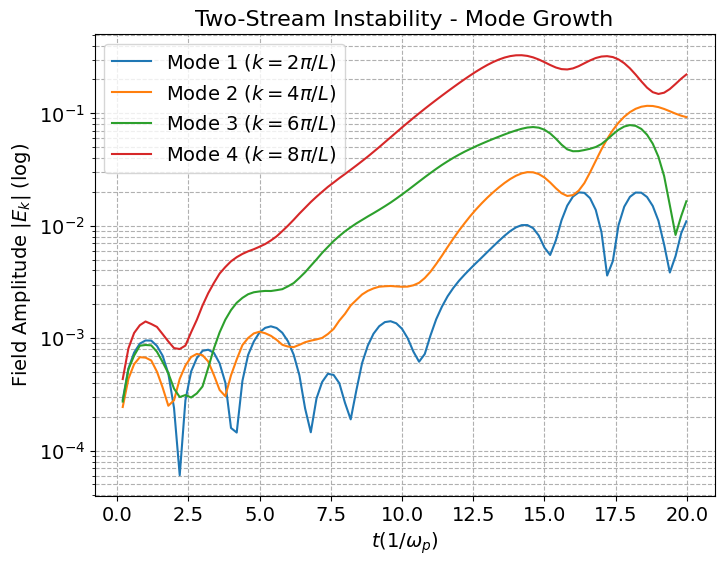

m=1:  k = 0.209440 (1/lambdaD)
m=2:  k = 0.418879 (1/lambdaD)
m=3:  k = 0.628319 (1/lambdaD)
m=4:  k = 0.837758 (1/lambdaD)


In [22]:
import numpy as np
import matplotlib.pyplot as plt
from diag_utils import load_modes_history


data = load_modes_history(OUT)
t = data[:, 0]
t_plt = t * param.dt  # 转为物理时间
mode1 = data[:, 1]
mode2 = data[:, 2]
mode3 = data[:, 3]
mode4 = data[:, 4]

plt.figure(figsize=(8, 6))
plt.semilogy(t_plt, mode1, label='Mode 1 ($k=2\pi/L$)')
plt.semilogy(t_plt, mode2, label='Mode 2 ($k=4\pi/L$)')
plt.semilogy(t_plt, mode3, label='Mode 3 ($k=6\pi/L$)')
plt.semilogy(t_plt, mode4, label='Mode 4 ($k=8\pi/L$)')
plt.xlabel('$t (1/\omega_p)$', fontsize=14)
plt.ylabel('Field Amplitude $|E_k|$ (log)', fontsize=14)
plt.title('Two-Stream Instability - Mode Growth', fontsize=16)
plt.legend(fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(True, which="both", ls="--")
plt.show()

for m in range(1, 5):   # m = 1,2,3,4
    k_m = 2 * np.pi * m / param.Lx
    k_phys = k_m * (1/param.lambdaD_SI) 
    print(f"m={m}:  k = {k_m:.6f} (1/lambdaD)")
    # print(f"m={m}:  k (1/lambdaD_total_sim) = {k_m:.6f},   k (1/lambdaD_beam_disp) = {k_phys:.6f}")
    

Fitted line: log(W_E) = -8.135e+00 + 8.402e-03 * t
γ (from energy fit) = 4.201e-01  (omega_p_beam)
γ (from energy fit) = 7.495e+08  (1/s)


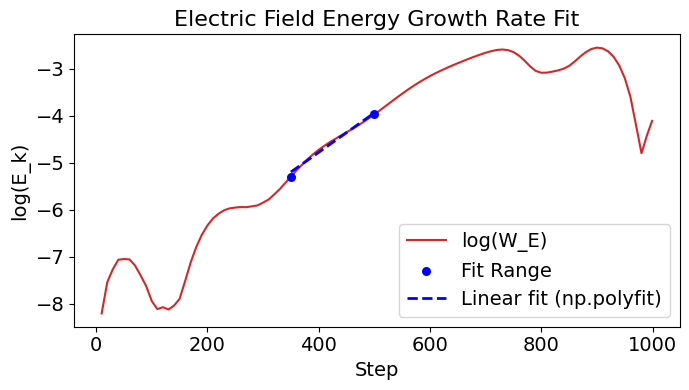

In [24]:
# 选择拟合区间
fit_start = 350      
fit_end   = 500      

# 转换为索引
mask = (t >= fit_start) & (t <= fit_end)

t_fit  = t[mask]
mode = mode3
logmode = np.log(np.maximum(mode, 1e-30))
logmode_fit = logmode[mask]
# 绘制原始能量曲线
plt.figure(figsize=(7,4))
plt.plot(t, logmode, color='tab:red', label="log(W_E)")


# 画出拟合区间的两个端点
plt.scatter([t_fit[0], t_fit[-1]],
            [logmode_fit[0], logmode_fit[-1]],
            color='blue', s=30, zorder=5, label="Fit Range")

# 用 np.polyfit 做线性拟合：log(W_E) ≈ a + b t
# polyfit 返回 [b, a]，b 是斜率，a 是截距
b, a = np.polyfit(t_fit, logmode_fit, 1)
print(f"Fitted line: log(W_E) = {a:.3e} + {b:.3e} * t")

# 对幅度来说：E_k ~ exp(γ t)，所以 log(E_k) ~ const + γ t
# 因此 b = γ
gamma =  b # 1/step
gamma = gamma / param.dt   # 1/dimensionless time unit
print(f"γ (from energy fit) = {gamma:.3e}  (omega_p_beam)")
print(f"γ (from energy fit) = {gamma * omegap_beamn0_SI:.3e}  (1/s)")

# 拟合直线在整个 t_fit 上的值
mode_fit = a + b * t_fit

# 拟合直线（虚线）
plt.plot(t_fit, mode_fit,
         linestyle='--', color='blue', linewidth=2,
         label="Linear fit (np.polyfit)")

plt.xlabel("Step", fontsize=14)
plt.ylabel("log(E_k)", fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.title("Electric Field Energy Growth Rate Fit", fontsize=16)
plt.legend(fontsize=14)
plt.tight_layout()
plt.show()


v0/vth = 1.0
maximum growthrate γ_max = 0.5000 omega_p_beam
corresponding k = 0.8659 (omega_p_beam/vth_T=1eV)


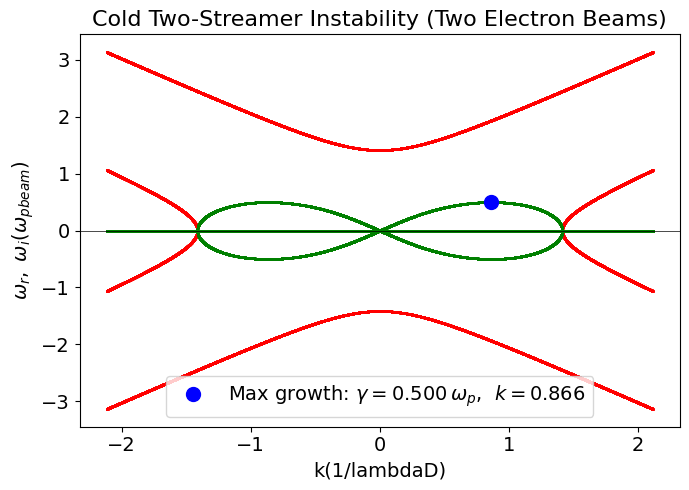

In [8]:
import numpy as np
import matplotlib.pyplot as plt

def two_electron_stream_roots(k_array, v0=2.0, omega_p=1.0, use_beam_freq=True):
    """
    对称两电子冷流色散关系数值解：
        1 - ω_pb^2/(ω - k v0)^2 - ω_pb^2/(ω + k v0)^2 = 0

    参数
    ----
    omega_p : float
        如果 use_beam_freq=True，则 omega_p = ω_pb（单束频率）
        如果 use_beam_freq=False，则 omega_p = ω_pe（总电子频率），此时 ω_pb^2 = ω_pe^2 / 2
    """
    k_array = np.asarray(k_array)

    if use_beam_freq:
        alpha = omega_p**2          # α = ω_pb^2
    else:
        alpha = 0.5 * omega_p**2    # α = ω_pb^2 = ω_pe^2 / 2

    omegas = []
    for k in k_array:
        kv = k * v0

        a4 = 1.0
        a3 = 0.0
        a2 = -(2*kv**2 + 2*alpha)
        a1 = 0.0
        a0 = kv**4 - 2*alpha*kv**2   

        roots = np.roots([a4, a3, a2, a1, a0])
        omegas.append(roots)

    return np.array(omegas).T   # shape (4, len(k))



if __name__ == "__main__":
    # === parameters ===
    # v0 = param.v0*vth_ref_SI      # unit is m/s
    v0 = param.v0*vth_ref_SI      # unit is m/s
    omega_pb = omegap_beamn0_SI # unit is 1/s plasma frequency calculated from real beam electron density
    lambdaD_SI
    # k unit is same as the unit of omega_pb / v0, which means omega_pb/vth
    k_array = np.linspace(-9000, 9000, 9000) 

    omega = two_electron_stream_roots(k_array, v0=v0, omega_p=omega_pb)
    wr = omega.real
    wi = omega.imag

    # === find maximum growth ===
    mask = k_array > 0
    wi_pos = wi[:, mask].copy()
    wi_pos[wi_pos < 0] = 0

    idx_branch, idx_k_sub = np.unravel_index(np.argmax(wi_pos), wi_pos.shape)
    idx_k = np.where(mask)[0][idx_k_sub]

    k_max = k_array[idx_k]
    omega_i_max = wi[idx_branch, idx_k]

    print("v0/vth =", param.v0)
    print(f"maximum growthrate γ_max = {omega_i_max/omega_pb:.4f} omega_p_beam")
    print(f"corresponding k = {k_max/(1/lambdaD_SI):.4f} (omega_p_beam/vth_T=1eV)")


    # === plot ===
    plt.figure(figsize=(7,5))

    # real parts
    for j in range(4):
        plt.plot(k_array/(1/lambdaD_SI), wr[j]/omega_pb, 'r.', ms=2)

    # imaginary parts
    for j in range(4):
        plt.plot(k_array/(1/lambdaD_SI), wi[j]/omega_pb, 'g.', ms=2)
    # highlight max growth
    plt.plot(k_max/(1/lambdaD_SI), omega_i_max/omega_pb, 'bo', ms=10,
             label=fr"Max growth: $\gamma={omega_i_max/omega_pb:.3f}\,\omega_p$,  $k={k_max/(1/lambdaD_SI):.3f}$")


    plt.axhline(0, color='k', lw=0.5)
    plt.xlabel("k(1/lambdaD)", fontsize=14)
    plt.ylabel(r"$\omega_r,\ \omega_i  (\omega_{pbeam})$", fontsize=14)
    plt.title("Cold Two-Streamer Instability (Two Electron Beams)", fontsize=16)
    plt.legend(fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.tight_layout()
    plt.show()


=== Maximum growth rate (k>0) ===
v0/vth = 1.0
γ_max = 0.5000 ω_p
k_max(norm) = 0.8659
Generated k_norm_list = [0.20943951023931953, 0.41887902047863906, 0.6283185307179586, 0.8377580409572781]


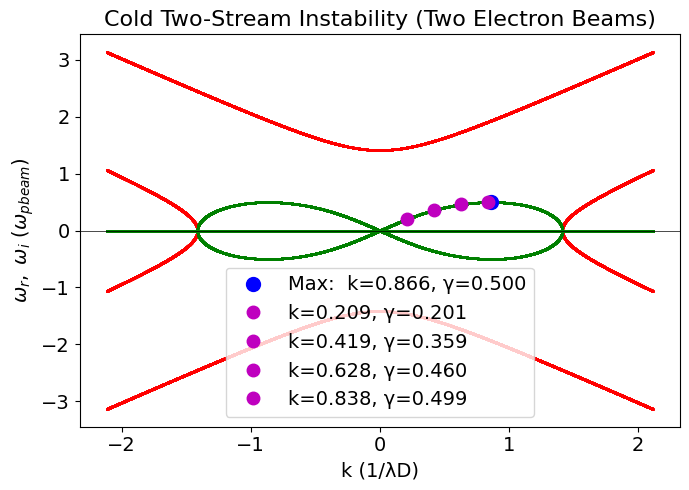

In [9]:
import numpy as np
import matplotlib.pyplot as plt

def two_electron_stream_roots(k_array, v0=2.0, omega_p=1.0, use_beam_freq=True):
    """
    对称两电子冷流：
        1 - ω_pb^2/(ω - k v0)^2 - ω_pb^2/(ω + k v0)^2 = 0
    求 ω(k) 的四个根
    """
    k_array = np.asarray(k_array)

    # α = ω_pb^2
    alpha = omega_p**2 if use_beam_freq else 0.5 * omega_p**2

    omegas = []
    for k in k_array:
        kv = k * v0

        a4 = 1.0
        a3 = 0.0
        a2 = -(2*kv**2 + 2*alpha)
        a1 = 0.0
        a0 = kv**4 - 2*alpha*kv**2   

        roots = np.roots([a4, a3, a2, a1, a0])
        omegas.append(roots)

    return np.array(omegas).T   # shape (4, len(k))



# ================================================
# ==========            MAIN            ==========
# ================================================
if __name__ == "__main__":

    # === parameters ===
    v0 = param.v0 * vth_ref_SI         # m/s
    omega_pb = omegap_beamn0_SI        # 1/s
    # lambdaD_SI must already be defined

    k_array = np.linspace(-9000, 9000, 9000)

    omega = two_electron_stream_roots(k_array, v0=v0, omega_p=omega_pb)
    wr = omega.real
    wi = omega.imag


    # ============================================
    # 1. 求最大增长率，只看 k>0
    # ============================================
    mask = k_array > 0
    wi_pos = wi[:, mask].copy()
    wi_pos[wi_pos < 0] = 0

    idx_branch, idx_k_sub = np.unravel_index(np.argmax(wi_pos), wi_pos.shape)
    idx_k = np.where(mask)[0][idx_k_sub]

    k_max = k_array[idx_k]
    omega_i_max = wi[idx_branch, idx_k]

    print("=== Maximum growth rate (k>0) ===")
    print(f"v0/vth = {param.v0}")
    print(f"γ_max = {omega_i_max/omega_pb:.4f} ω_p")
    print(f"k_max(norm) = {k_max/(1/lambdaD_SI):.4f}")


    # ============================================
    # 2. 输入多个模式（k_norm = k λD）
    # ============================================
    # 手动输入你想标记的 kλD 值：
    k_norm_list = []

    for m in range(1, 5):   # m = 1,2,3,4
        k_norm = 2 * np.pi * m / param.Lx    
        k_norm_list.append(k_norm)

    print("Generated k_norm_list =", k_norm_list)


    # 如果你想用 mode (k=2πm/L)，取消下面注释：
    # m_list = [1, 2, 3, 4]
    # k_norm_list = [(2*np.pi*m / Lx_SI) * lambdaD_SI for m in m_list]

    query_points = []

    for k_norm in k_norm_list:

        k_phys = k_norm / lambdaD_SI
        idx_q = np.argmin(np.abs(k_array - k_phys))

        omega_i = wi[:, idx_q].max()
        omega_r = wr[:, idx_q][np.argmax(wi[:, idx_q])]

        query_points.append((k_norm, k_array[idx_q], omega_i))

        # print(f"\nInput k_norm = {k_norm}")
        # print(f"Closest sample k = {k_array[idx_q]:.4e}")
        # print(f"γ = {omega_i/omega_pb:.4f} ω_p")
        # print(f"ω_r = {omega_r/omega_pb:.4f} ω_p")


    # ============================================
    # 3. 绘图
    # ============================================
    plt.figure(figsize=(7,5))

    # 画 wr(k)
    for j in range(4):
        plt.plot(k_array/(1/lambdaD_SI), wr[j]/omega_pb, 'r.', ms=2)

    # 画 wi(k)
    for j in range(4):
        plt.plot(k_array/(1/lambdaD_SI), wi[j]/omega_pb, 'g.', ms=2)

    # 标出最大增长率点（蓝点）
    plt.plot(
        k_max/(1/lambdaD_SI), omega_i_max/omega_pb,
        'bo', ms=10,
        label=fr"Max:  k={k_max/(1/lambdaD_SI):.3f}, γ={omega_i_max/omega_pb:.3f}"
    )

    # 标出多个模式（紫点）
    for k_norm, k_val, omega_i_val in query_points:
        plt.plot(
            k_val/(1/lambdaD_SI), omega_i_val/omega_pb,
            'mo', ms=9,
            label=fr"k={k_norm:.3f}, γ={omega_i_val/omega_pb:.3f}"
        )

    plt.axhline(0, color='k', lw=0.5)
    plt.xlabel("k (1/λD)", fontsize=14)
    plt.ylabel(r"$\omega_r,\ \omega_i\ (\omega_{pbeam})$", fontsize=14)
    plt.title("Cold Two-Stream Instability (Two Electron Beams)", fontsize=16)
    plt.legend(fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.tight_layout()
    plt.show()



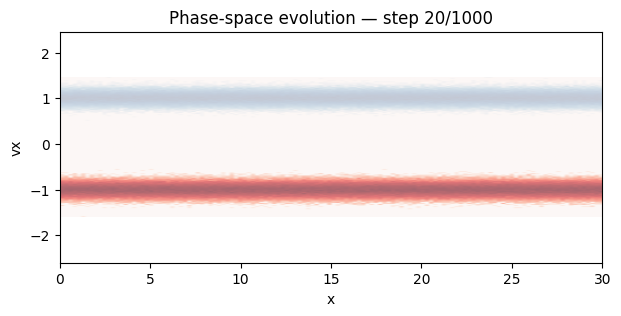

In [16]:
# diagnostics/make_phase_movie_html.py
import os, glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from diag_utils import ensure_dir
from config_paths import OUT, FIGS
from IPython.display import HTML

# 自动创建输出目录
files = sorted(glob.glob(os.path.join(OUT, "phase_*.npz")))
if not files:
    raise FileNotFoundError("❌ 未找到 phase_*.npz 文件，请先运行模拟。")

# 图设置
fig, ax = plt.subplots(figsize=(7,3))

def draw(i):
    d = np.load(files[i])

    # 获取三个 histogram（如果只存在 H_all，就退回老模式）
    if "H0" in d and "H1" in d and "H_all" in d:
        H0 = d["H0"]
        H1 = d["H1"]
        H_all = d["H_all"]
    else:
        # 老数据兼容：只有 H
        H_all = d["H"]
        H0 = None
        H1 = None

    xedges, vedges = d["xedges"], d["vedges"]

    # meta 优先（保存的 vmin/vmax）
    if "meta" in d:
        vmin, vmax, _ = d["meta"]
    else:
        vmin = vedges[0]; vmax = vedges[-1]

    ax.clear()

    # === 绘制 label=0 （蓝色流） ===
    if H0 is not None:
        ax.imshow(np.log10(H0.T + 1),
                  origin="lower",
                  extent=[xedges[0], xedges[-1], vmin, vmax],
                  aspect="auto",
                  cmap="Blues",
                  alpha=0.6)

    # === 绘制 label=1 （红色流） ===
    if H1 is not None:
        ax.imshow(np.log10(H1.T + 1),
                  origin="lower",
                  extent=[xedges[0], xedges[-1], vmin, vmax],
                  aspect="auto",
                  cmap="Reds",
                  alpha=0.6)

    # === 绘制全部背景（可选） ===
    # ax.imshow(np.log10(H_all.T + 1),
    #           origin="lower",
    #           extent=[xedges[0], xedges[-1], vmin, vmax],
    #           aspect="auto",
    #           cmap="Greys",
    #           alpha=0.2)

    ax.set_xlabel("x")
    ax.set_ylabel("vx")
    # v axis limits
    ax.set_ylim(vmin-1, vmax+1)
    ax.set_title(f"Phase-space evolution — step {(i+1)*param.phase_snap}/{param.steps}")

    return []

ani = FuncAnimation(fig, draw, frames=len(files), interval=120, blit=False)

html_path = os.path.join(FIGS, "phase_evolution.html")
html_str = ani.to_jshtml()

try:
    display(HTML(html_str))
except Exception:
    print("ℹ️ 可手动在浏览器中打开 HTML 查看动画。")

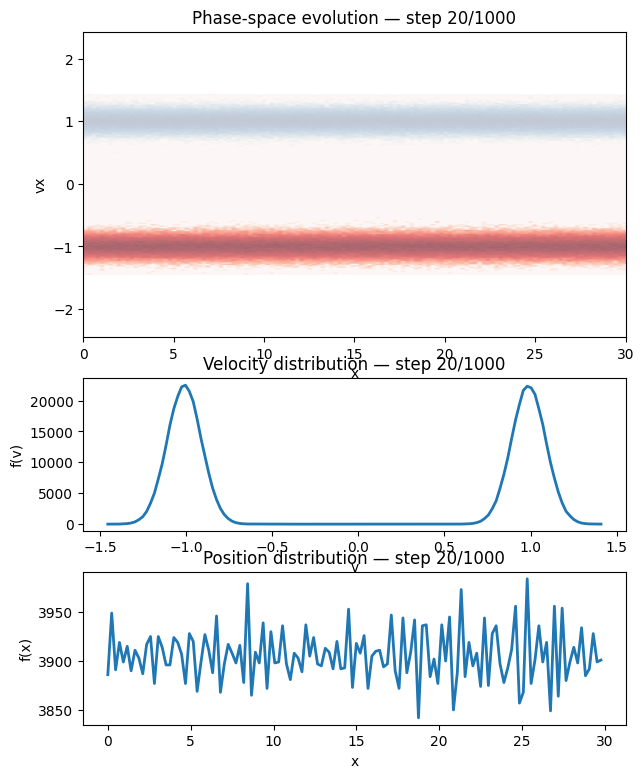

In [8]:
# diagnostics/make_phase_movie_html.py
import os, glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from diag_utils import ensure_dir
from config_paths import OUT, FIGS
from IPython.display import HTML
import matplotlib.gridspec as gridspec

# 自动创建输出目录
files = sorted(glob.glob(os.path.join(OUT, "phase_*.npz")))
if not files:
    raise FileNotFoundError("❌ 未找到 phase_*.npz 文件，请先运行模拟。")

# ========= 三行布局 =========
fig = plt.figure(figsize=(7,9))
gs = gridspec.GridSpec(3, 1, height_ratios=[2, 1, 1])

ax_phase = fig.add_subplot(gs[0])   # 原相空间图
ax_vdist = fig.add_subplot(gs[1])   # f(v)
ax_xdist = fig.add_subplot(gs[2])   # f(x)

def draw(i):
    d = np.load(files[i])

    # ↓↓↓↓↓↓↓↓↓↓↓↓↓ 你的原代码区域完全不修改，只把 ax 换成 ax_phase ↓↓↓↓↓↓↓↓↓↓↓↓↓

    if "H0" in d and "H1" in d and "H_all" in d:
        H0 = d["H0"]
        H1 = d["H1"]
        H_all = d["H_all"]
    else:
        H_all = d["H"]
        H0 = None
        H1 = None

    xedges, vedges = d["xedges"], d["vedges"]

    if "meta" in d:
        vmin, vmax, _ = d["meta"]
    else:
        vmin = vedges[0]; vmax = vedges[-1]

    ax_phase.clear()

    if H0 is not None:
        ax_phase.imshow(np.log10(H0.T + 1),
                      origin="lower",
                      extent=[xedges[0], xedges[-1], vmin, vmax],
                      aspect="auto",
                      cmap="Blues",
                      alpha=0.6)

    if H1 is not None:
        ax_phase.imshow(np.log10(H1.T + 1),
                      origin="lower",
                      extent=[xedges[0], xedges[-1], vmin, vmax],
                      aspect="auto",
                      cmap="Reds",
                      alpha=0.6)

    ax_phase.set_xlabel("x")
    ax_phase.set_ylabel("vx")
    ax_phase.set_ylim(vmin-1, vmax+1)
    ax_phase.set_title(f"Phase-space evolution — step {(i+1)*param.phase_snap}/{param.steps}")

    # ↑↑↑↑↑↑↑↑↑↑↑↑↑ 你的原代码区域保持不动到此 ↑↑↑↑↑↑↑↑↑↑↑↑↑


    # =============== 新增：速度分布 f(v) = ∑_x H_all(x,v) ===============
    ax_vdist.clear()

    f_v = np.sum(H_all, axis=0)  # sum over x bins
    ax_vdist.plot(vedges[:-1], f_v, lw=2)
    ax_vdist.set_xlabel("v")
    ax_vdist.set_ylabel("f(v)")
    ax_vdist.set_title(f"Velocity distribution — step {(i+1)*param.phase_snap}/{param.steps}")


    # =============== 新增：位置分布 f(x) = ∑_v H_all(x,v) ===============
    ax_xdist.clear()

    f_x = np.sum(H_all, axis=1)  # sum over v bins
    ax_xdist.plot(xedges[:-1], f_x, lw=2)
    ax_xdist.set_xlabel("x")
    ax_xdist.set_ylabel("f(x)")
    ax_xdist.set_title(f"Position distribution — step {(i+1)*param.phase_snap}/{param.steps}")

    return []

ani = FuncAnimation(fig, draw, frames=len(files), interval=120, blit=False)

html_path = os.path.join(FIGS, "phase_evolution.html")
html_str = ani.to_jshtml()

try:
    display(HTML(html_str))
except Exception:
    print("ℹ️ 可手动在浏览器中打开 HTML 查看动画。")


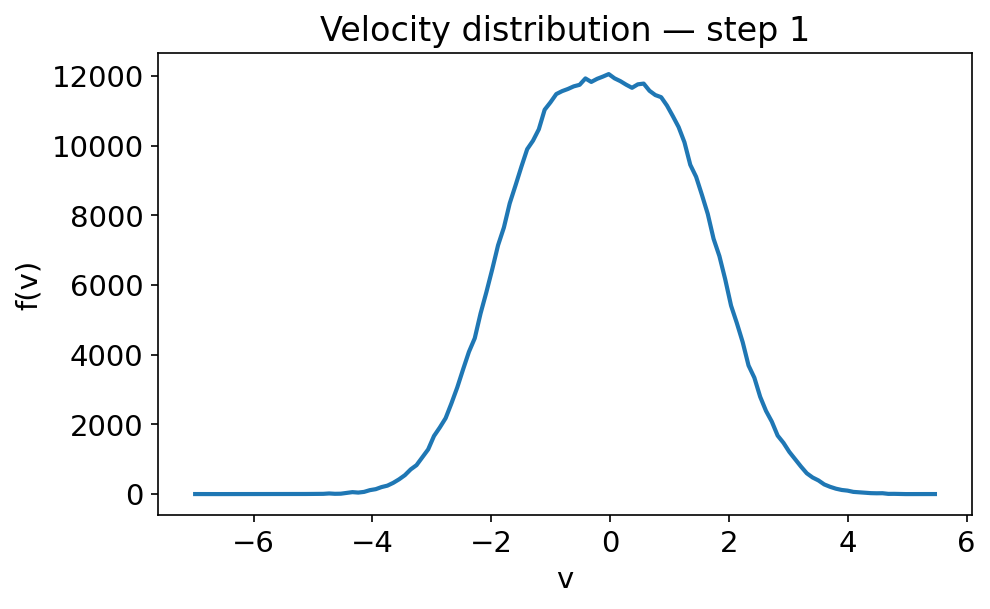

In [ ]:
# diagnostics/make_phase_movie_html.py
import os, glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from diag_utils import ensure_dir
from config_paths import OUT, FIGS
from IPython.display import HTML
import matplotlib.gridspec as gridspec

# 自动创建输出目录
files = sorted(glob.glob(os.path.join(OUT, "phase_*.npz")))
if not files:
    raise FileNotFoundError("❌ 未找到 phase_*.npz 文件，请先运行模拟。")

# ========= 单图布局：只显示 f(v) =========
fig = plt.figure(figsize=(7,4),dpi=100)
ax_vdist = fig.add_subplot(111)

def draw(i):
    d = np.load(files[i])

    # ===== 仍然识别 H_all（你的原逻辑保留）=====
    if "H0" in d and "H1" in d and "H_all" in d:
        H_all = d["H_all"]
    else:
        H_all = d["H"]

    vedges = d["vedges"]

    # ===== 速度分布 f(v) =====
    ax_vdist.clear()

    f_v = np.sum(H_all, axis=0)  # sum over x bins
    ax_vdist.plot(vedges[:-1], f_v, lw=2)

    ax_vdist.set_xlabel("v", fontsize=14)
    ax_vdist.set_ylabel("f(v)", fontsize=14)
    ax_vdist.set_title(f"Velocity distribution — step {i+1}", fontsize=16)
    ax_vdist.tick_params(axis='both', which='major', labelsize=14)

    return []

ani = FuncAnimation(fig, draw, frames=len(files), interval=120, blit=False)

html_path = os.path.join(FIGS, "velocity_distribution.html")
html_str = ani.to_jshtml()

try:
    display(HTML(html_str))
except Exception:
    print("ℹ️ 可手动在浏览器中打开 HTML 查看动画。")


C:\Users\Qien Jing\AppData\Local\Temp\ipykernel_51504\2026424330.py:98: UserWarning: You passed in an explicit save_count=0 which is being ignored in favor of frames=50.
  ani = FuncAnimation(


Static frame saved to: ../output/figs\frame_800.png


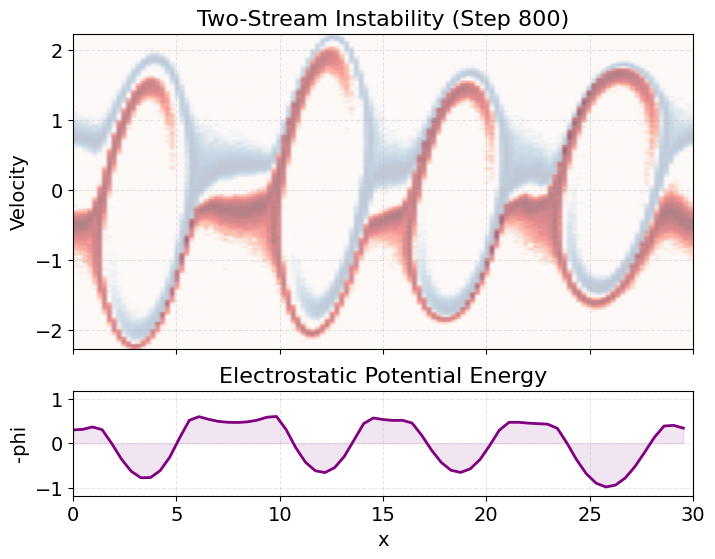

In [ ]:
import os, glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

# ================================
# 配置
# ================================
OUT = "../output"
FIGS = "../output/figs"
os.makedirs(FIGS, exist_ok=True)

STATIC_STEP = 800   # 想提取的静态图 frame

# ================================
# 加载文件列表
# ================================
phase_files = sorted(glob.glob(os.path.join(OUT, "phase_*.npz")))
if not phase_files:
    raise FileNotFoundError("No phase_*.npz found.")

def step_from_name(f):
    return int(os.path.basename(f).split("_")[1].split(".")[0])

# ================================
# 创建画布（三行：phase, phi, velocity distribution）
# ================================
fig, (ax_phase, ax_phi, ax_vdist) = plt.subplots(
    3, 1, figsize=(8, 9), sharex=False,
    gridspec_kw={'height_ratios': [3, 1, 1.2], 'hspace': 0.35}
)

# ================================
# 核心：绘图函数（动画 + 静态图通用）
# ================================
def draw(i):
    f = phase_files[i]
    d = np.load(f)

    step = d["step"] if "step" in d else step_from_name(f)
    xedges, vedges = d["xedges"], d["vedges"]
    vmin, vmax = vedges[0], vedges[-1]

    H0 = d["H0"] if "H0" in d else None
    H1 = d["H1"] if "H1" in d else None
    H  = d["H"]  if "H"  in d else d.get("H_all", None)

    # ------------------------------
    # 1) Phase-space plot
    # ------------------------------
    ax_phase.clear()
    if H0 is not None:
        ax_phase.imshow(np.log10(H0.T + 1), origin="lower",
                        extent=[xedges[0], xedges[-1], vmin, vmax],
                        cmap="Blues", alpha=0.5, aspect="auto")
    if H1 is not None:
        ax_phase.imshow(np.log10(H1.T + 1), origin="lower",
                        extent=[xedges[0], xedges[-1], vmin, vmax],
                        cmap="Reds", alpha=0.5, aspect="auto")
    if H is not None and H0 is None:
        ax_phase.imshow(np.log10(H.T + 1), origin="lower",
                        extent=[xedges[0], xedges[-1], vmin, vmax],
                        cmap="Greys", alpha=0.8, aspect="auto")

    ax_phase.set_title(f"Two-Stream Instability (Step {step})", fontsize=16)
    ax_phase.set_ylabel("Velocity", fontsize=14)
    ax_phase.grid(True, linestyle="--", alpha=0.3)
    ax_phase.tick_params(axis='both', which='major', labelsize=14)

    # ------------------------------
    # 2) Phi plot
    # ------------------------------
    ax_phi.clear()
    f_field = os.path.join(OUT, f"fields_{step:05d}.npz")
    if os.path.exists(f_field):
        df = np.load(f_field)
        phi = df["phi"]
        x  = df["x"] if "x" in df else np.linspace(xedges[0], xedges[-1], len(phi))

        ax_phi.plot(x, -1 * phi, color="purple", lw=2)
        ax_phi.fill_between(x, -1 * phi, alpha=0.1, color="purple")

        y = np.max(np.abs(phi))
        y = y if y > 0 else 1e-5
        ax_phi.set_ylim(-1.2 * y, 1.2 * y)
    else:
        ax_phi.text(0.5, 0.5, "Phi missing", ha="center", transform=ax_phi.transAxes)

    ax_phi.set_ylabel("-phi", fontsize=14)
    ax_phi.grid(True, linestyle="--", alpha=0.3)
    ax_phi.set_title("Electrostatic Potential", fontsize=16)
    ax_phi.tick_params(axis='both', which='major', labelsize=14)

    # ------------------------------
    # 3) Velocity distribution f(v)
    # ------------------------------
    ax_vdist.clear()

    # --- Compute f(v) = ∫ H(x,v) dx ---
    if H is not None:
        f_v = np.sum(H, axis=0)   # integrate over x
    elif H0 is not None and H1 is not None:
        f_v = np.sum(H0 + H1, axis=0)
    else:
        f_v = None

    if f_v is not None:
        vcenters = 0.5 * (vedges[:-1] + vedges[1:])
        ax_vdist.plot(vcenters, f_v, color="darkgreen", lw=2)
        ax_vdist.fill_between(vcenters, f_v, alpha=0.15, color="darkgreen")
        ax_vdist.set_xlim(vmin, vmax)

    ax_vdist.set_xlabel("Velocity", fontsize=14)
    ax_vdist.set_ylabel("f(v)", fontsize=14)
    ax_vdist.set_title("Velocity Distribution", fontsize=16)
    ax_vdist.grid(True, linestyle="--", alpha=0.3)
    ax_vdist.tick_params(axis='both', which='major', labelsize=14)

    return []

# ================================
# 创建动画
# ================================
ani = FuncAnimation(
    fig, draw, frames=len(phase_files),
    interval=100, blit=False, repeat=False,
    save_count=0
)

html = ani.to_jshtml()
display(HTML(html))

# ================================
# 绘制静态帧
# ================================
idx = next(i for i, f in enumerate(phase_files) if step_from_name(f) == STATIC_STEP)

draw(idx)

out_static = os.path.join(FIGS, f"frame_{STATIC_STEP}.png")
fig.savefig(out_static, dpi=200)
print("Static frame saved to:", out_static)

plt.show()


C:\Users\Qien Jing\AppData\Local\Temp\ipykernel_49816\935909637.py:125: UserWarning: You passed in an explicit save_count=0 which is being ignored in favor of frames=50.
  ani = FuncAnimation(


Static frame saved to: ../output/figs\frame_20.png


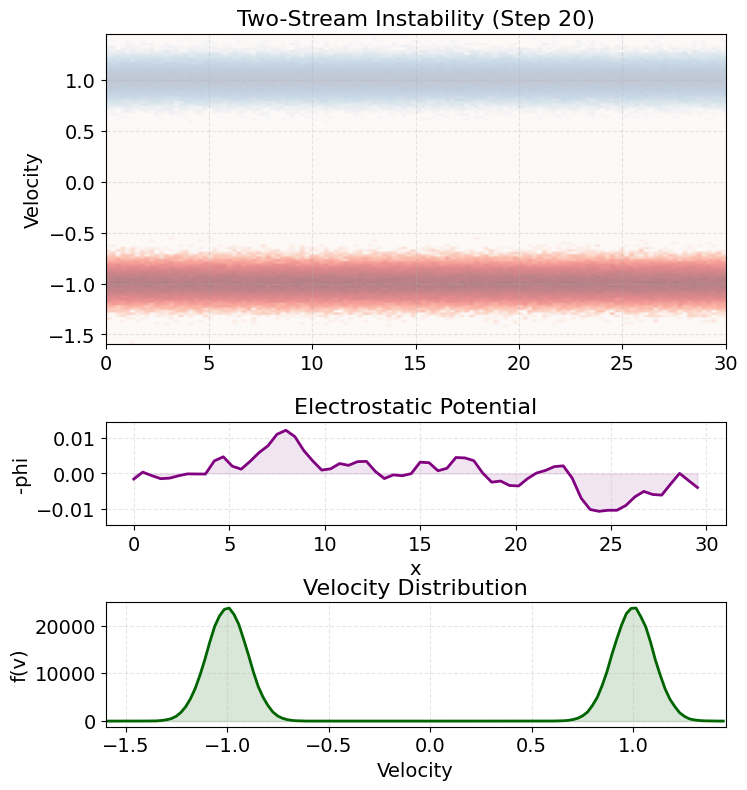

In [9]:
import os, glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

# ================================
# 配置
# ================================
OUT = "../output"
FIGS = "../output/figs"
os.makedirs(FIGS, exist_ok=True)

STATIC_STEP = 20   # 想提取的静态图 frame

# ================================
# 加载文件列表
# ================================
phase_files = sorted(glob.glob(os.path.join(OUT, "phase_*.npz")))
if not phase_files:
    raise FileNotFoundError("No phase_*.npz found.")

def step_from_name(f):
    return int(os.path.basename(f).split("_")[1].split(".")[0])

# ================================
# 创建画布（三行：phase, phi, velocity distribution）
# ================================
fig, (ax_phase, ax_phi, ax_vdist) = plt.subplots(
    3, 1, figsize=(8, 9), sharex=False,
    gridspec_kw={'height_ratios': [3, 1, 1.2], 'hspace': 0.43}
)

# ================================
# 核心：绘图函数（动画 + 静态图通用）
# ================================
def draw(i):
    f = phase_files[i]
    d = np.load(f)

    step = d["step"] if "step" in d else step_from_name(f)
    xedges, vedges = d["xedges"], d["vedges"]
    vmin, vmax = vedges[0], vedges[-1]

    H0 = d["H0"] if "H0" in d else None
    H1 = d["H1"] if "H1" in d else None
    H  = d["H"]  if "H"  in d else d.get("H_all", None)

    # ------------------------------
    # 1) Phase-space plot
    # ------------------------------
    ax_phase.clear()
    if H0 is not None:
        ax_phase.imshow(np.log10(H0.T + 1), origin="lower",
                        extent=[xedges[0], xedges[-1], vmin, vmax],
                        cmap="Blues", alpha=0.5, aspect="auto")
    if H1 is not None:
        ax_phase.imshow(np.log10(H1.T + 1), origin="lower",
                        extent=[xedges[0], xedges[-1], vmin, vmax],
                        cmap="Reds", alpha=0.5, aspect="auto")
    if H is not None and H0 is None:
        ax_phase.imshow(np.log10(H.T + 1), origin="lower",
                        extent=[xedges[0], xedges[-1], vmin, vmax],
                        cmap="Greys", alpha=0.8, aspect="auto")

    ax_phase.set_title(f"Two-Stream Instability (Step {step})", fontsize=16)
    ax_phase.set_ylabel("Velocity", fontsize=14)
    ax_phase.grid(True, linestyle="--", alpha=0.3)
    ax_phase.tick_params(axis='both', which='major', labelsize=14)

    # ------------------------------
    # 2) Phi plot
    # ------------------------------
    ax_phi.clear()
    f_field = os.path.join(OUT, f"fields_{step:05d}.npz")
    if os.path.exists(f_field):
        df = np.load(f_field)
        phi = df["phi"]
        x  = df["x"] if "x" in df else np.linspace(xedges[0], xedges[-1], len(phi))

        ax_phi.plot(x, -1 * phi, color="purple", lw=2)
        ax_phi.fill_between(x, -1 * phi, alpha=0.1, color="purple")

        y = np.max(np.abs(phi))
        y = y if y > 0 else 1e-5
        ax_phi.set_ylim(-1.2 * y, 1.2 * y)
    else:
        ax_phi.text(0.5, 0.5, "Phi missing", ha="center", transform=ax_phi.transAxes)
    ax_phi.set_xlabel("x", fontsize=14)
    ax_phi.set_ylabel("-phi", fontsize=14)
    ax_phi.grid(True, linestyle="--", alpha=0.3)
    ax_phi.set_title("Electrostatic Potential", fontsize=16)
    ax_phi.tick_params(axis='both', which='major', labelsize=14)

    # ------------------------------
    # 3) Velocity distribution f(v)
    # ------------------------------
    ax_vdist.clear()

    # --- Compute f(v) = ∫ H(x,v) dx ---
    if H is not None:
        f_v = np.sum(H, axis=0)   # integrate over x
    elif H0 is not None and H1 is not None:
        f_v = np.sum(H0 + H1, axis=0)
    else:
        f_v = None

    if f_v is not None:
        vcenters = 0.5 * (vedges[:-1] + vedges[1:])
        ax_vdist.plot(vcenters, f_v, color="darkgreen", lw=2)
        ax_vdist.fill_between(vcenters, f_v, alpha=0.15, color="darkgreen")
        ax_vdist.set_xlim(vmin, vmax)

    ax_vdist.set_xlabel("Velocity", fontsize=14)
    ax_vdist.set_ylabel("f(v)", fontsize=14)
    ax_vdist.set_title("Velocity Distribution", fontsize=16)
    ax_vdist.grid(True, linestyle="--", alpha=0.3)
    ax_vdist.tick_params(axis='both', which='major', labelsize=14)

    return []

# ================================
# 创建动画
# ================================
ani = FuncAnimation(
    fig, draw, frames=len(phase_files),
    interval=100, blit=False, repeat=False,
    save_count=0
)

html = ani.to_jshtml()
display(HTML(html))

# ================================
# 绘制静态帧
# ================================
idx = next(i for i, f in enumerate(phase_files) if step_from_name(f) == STATIC_STEP)

draw(idx)

out_static = os.path.join(FIGS, f"frame_{STATIC_STEP}.png")
fig.savefig(out_static, dpi=200)
print("Static frame saved to:", out_static)

plt.show()


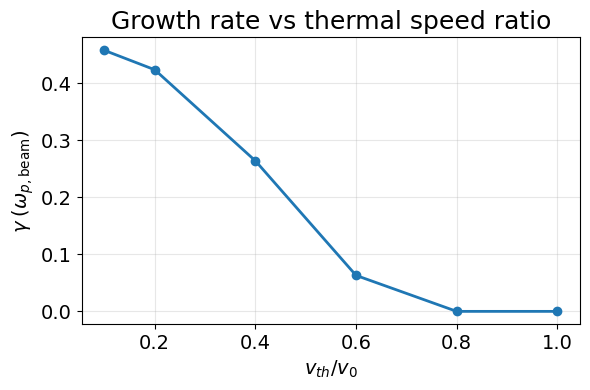

In [223]:
import numpy as np
import matplotlib.pyplot as plt

# 数据（根据你给的）
vth_list = np.array([0.1, 0.2, 0.4, 0.6, 0.8, 1.0])
gamma_list = np.array([
    4.581e-01,
    4.241e-01,
    2.642e-01,
    6.313e-02,
    0.0,
    0.0
])

v0 = 1.0   # 根据你的模拟参数

# 横坐标 = vth/v0
x = vth_list / v0

plt.figure(figsize=(6,4))
plt.plot(x, gamma_list, marker='o', linestyle='-', linewidth=2, markersize=6)

plt.xlabel(r"$v_{th}/v_0$", fontsize=14)
plt.ylabel(r"$\gamma \;(\omega_{p,\mathrm{beam}})$", fontsize=14)
plt.title("Growth rate vs thermal speed ratio", fontsize=18)
plt.tick_params(axis='both', which='major', labelsize=14)

plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig("gamma_vs_vth.png", dpi=300)
plt.show()

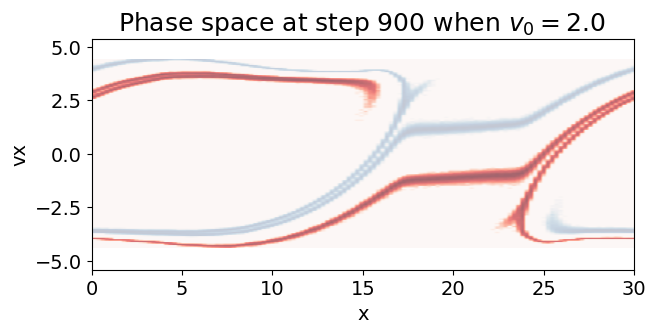

已输出: /Users/zhaohan/Documents/GitHub/Two-streamer-instability/output/figs/phase_step_900.png


In [224]:
import os, glob
import numpy as np
import matplotlib.pyplot as plt
from config_paths import OUT, FIGS

# ----------- 选择你想输出的 step -----------
target_step =900   # 你想保存的步数
fname = os.path.join(OUT, f"phase_{target_step:05d}.npz")

if not os.path.exists(fname):
    raise FileNotFoundError(f"未找到 {fname}，请检查目录与编号")

d = np.load(fname)

xedges = d["xedges"]
vedges = d["vedges"]

H0 = d.get("H0")
H1 = d.get("H1")
H_all = d.get("H_all", d.get("H")) # 兼容旧数据格式

# vmin/vmax
if "meta" in d:
    vmin, vmax, _ = d["meta"]
else:
    vmin = vedges[0]; vmax = vedges[-1]

# ----------- 画图开始 -----------
fig, ax = plt.subplots(figsize=(7,3))

if H0 is not None:
    ax.imshow(np.log10(H0.T+1), origin="lower",
              extent=[xedges[0], xedges[-1], vmin, vmax],
              cmap="Blues", aspect="auto", alpha=0.6)

if H1 is not None:
    ax.imshow(np.log10(H1.T+1), origin="lower",
              extent=[xedges[0], xedges[-1], vmin, vmax],
              cmap="Reds", aspect="auto", alpha=0.6)

ax.set_xlabel("x")
ax.set_ylabel("vx")
ax.set_ylim(vmin-1, vmax+1)
ax.set_title(f"Phase space at step {target_step} when $v_0 = 2.0$ ", fontsize=18)
ax.tick_params(axis='both', which='major', labelsize=14)
ax.set_xlabel("x", fontsize=14)
ax.set_ylabel("vx", fontsize=14)

# 保存输出
out_img = os.path.join(FIGS, f"phase_step_{target_step}.png")
plt.savefig(out_img, dpi=300)
plt.show()

print(f"已输出: {out_img}")